In [1]:
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.utils as vutils
import torchvision.datasets as dset
from torch.utils.data import DataLoader
import torchvision.transforms as transforms

import numpy as np
import matplotlib.pyplot as plt

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [2]:
dataroot = "./data"
image_size = 64
batch_size = 64
noise_channels = 100
num_workers = 4

In [3]:
transform = transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ])

dataset = dset.ImageFolder(root=dataroot, transform = transform)

dataloader = DataLoader(dataset, batch_size = batch_size, shuffle = True)

In [4]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [5]:
class Generator(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.block1 =  nn.Sequential(
            nn.ConvTranspose2d(noise_channels, 512, 4, 1, 0, bias = False),
            nn.BatchNorm2d(512),
            nn.ReLU(True)
        )
        
        self.block2 = nn.Sequential(
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias = False),
            nn.BatchNorm2d(256),
            nn.ReLU(True)
        )
        
        self.block3 = nn.Sequential(
            nn.ConvTranspose2d(256, 128, 4, 2, 1, bias = False),
            nn.BatchNorm2d(128),
            nn.ReLU(True)
        )
        
        self.block4 = nn.Sequential(
            nn.ConvTranspose2d(128, 64, 4, 2, 1, bias = False),
            nn.BatchNorm2d(64),
            nn.ReLU(True)
        )
        
        self.block5 = nn.Sequential(
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias = False),
            nn.Tanh()
        )
        
    def forward(self, image):
        x = self.block1(image)
        x = self.block2(x)
        x = self.block3(x)
        x = self.block4(x)
        x = self.block5(x)
        
        return x

In [6]:
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        
        self.block1 = nn.Sequential(
            nn.Conv2d(3, 64, 4, 2, 1, bias = False),
            nn.BatchNorm2d(64),
            nn.LeakyReLU(0.2, inplace=True),
        )
        
        self.block2 = nn.Sequential(
            nn.Conv2d(64, 128, 4, 2, 1, bias = False),
            nn.BatchNorm2d(128),
            nn.LeakyReLU(0.2, inplace=True),
        )
        
        self.block3 = nn.Sequential(
            nn.Conv2d(128, 256, 4, 2, 1, bias = False),
            nn.BatchNorm2d(256),
            nn.LeakyReLU(0.2, inplace=True),
        )
        
        self.block4 = nn.Sequential(
            nn.Conv2d(256, 512, 4, 2, 1, bias = False),
            nn.BatchNorm2d(512),
            nn.LeakyReLU(0.2, inplace=True),
        )
        
        self.block5 = nn.Sequential(
            nn.Conv2d(512, 1, 4, 2, 0, bias = False),
            nn.Sigmoid()
        )
    
    def forward(self, image):
        x = self.block1(image)
        x = self.block2(x)
        x = self.block3(x)
        x = self.block4(x)
        x = self.block5(x)
        
        return x

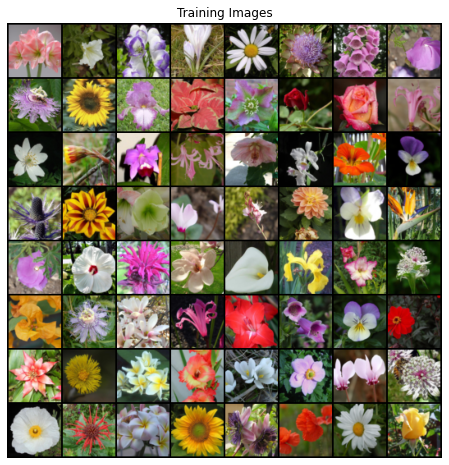

In [7]:
images = next(iter(dataloader))[0]
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(images.to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [8]:
"""
D Loss = max(log(D(x)) + log(1 - D(G(z))))

G Loss = max(log(D(G(z))))
"""

def trainGAN(dataloader, generator, discriminator, optimG, optimD, criterion, epochs, fixed_noise):
    img_list = []
    iterations = 0
    generator_loss = []
    discriminator_loss = []
    
    for epoch in range(epochs):
        for i, (images, labels) in enumerate(dataloader):
            images = images.to(device)
            
            noise = torch.randn(images.shape[0], noise_channels, 1, 1, device = device)
            
            # Step 1. Loss on real images from discriminator
            discriminator.zero_grad()
            real_labels = torch.full((images.shape[0],), 1., dtype = torch.float, device = device)
            
            outputD_Real = discriminator(images).view(-1)
            lossD_Real = criterion(outputD_Real, real_labels)
            lossD_Real.backward()
            
            
            # Step 2. Loss on generated image from discriminator
            fake_labels = torch.full((images.shape[0],), 0., dtype = torch.float, device = device)
            
            outputG_Fake = generator(noise)
            
            outputD_Fake = discriminator(outputG_Fake.detach()).view(-1)
            lossD_Fake = criterion(outputD_Fake, fake_labels)
            lossD_Fake.backward()
            
            lossD = lossD_Real + lossD_Fake

            optimD.step()
            
            
            # Step 3. Loss on generated image from generator
            generator.zero_grad()
            real_labels = torch.full((images.shape[0],), 1., dtype = torch.float, device = device)
            
            outputGD_Fake = discriminator(outputG_Fake).view(-1)
            lossG = criterion(outputGD_Fake, real_labels)
            lossG.backward()
            
            optimG.step()
            
            if i % int(len(dataloader)/5) == 0:
                print(f"Epoch: {epoch} itr: {i}/{len(dataloader)}, DLoss: {round(lossD.item(), 5)}, GLoss: {round(lossG.item(), 5)}, {round(outputD_Real.mean().item(), 5)}, {round(outputD_Fake.mean().item(), 5)}, {round(outputGD_Fake.mean().item(), 5)}")
            
            generator_loss.append(lossG.item())
            discriminator_loss.append(lossD.item())
            
            if iterations % int(len(dataloader)*epochs/40) == 0:
                with torch.no_grad():
                    generated_samples = generator(fixed_noise).detach().cpu()
                    img_list.append(generated_samples)
            
            iterations += 1
        
        if epoch % 5 == 0:
            torch.save({
            'epoch': epoch,
            'G_state_dict': generator.state_dict(),
            'D_state_dict': discriminator.state_dict(),
            'optimG_state_dict': optimG.state_dict(),
            'optimD_state_dict': optimD.state_dict(),
            }, "experiment data/" + str(epoch) + ".pt")
    
    return generator_loss, discriminator_loss, img_list

In [9]:
generator = Generator().to(device)
print(generator.apply(weights_init))

print("==============================================")

discriminator = Discriminator().to(device)
print(discriminator.apply(weights_init))

Generator(
  (block1): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (block2): Sequential(
    (0): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (block3): Sequential(
    (0): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (block4): Sequential(
    (0): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
  )
  (block5): Sequential(
    (0)

In [10]:
lr = 0.0002
beta1 = 0.5
epochs = 30

optimizerG = optim.Adam(generator.parameters(), lr = lr, betas=(beta1, 0.999))
optimizerD = optim.Adam(discriminator.parameters(), lr = lr, betas=(beta1, 0.999))
criterion = nn.BCELoss()

fixed_noise = torch.randn(64, noise_channels, 1, 1, device=device)

G_loss, D_loss, img_list = trainGAN(dataloader, generator, discriminator, optimizerG, optimizerD, criterion, epochs, fixed_noise)

Epoch: 0 itr: 0/128, DLoss: 1.69283, GLoss: 2.08838, 0.31734, 0.24969, 0.13632
Epoch: 0 itr: 25/128, DLoss: 1.51122, GLoss: 15.43567, 0.77031, 0.53692, 0.0
Epoch: 0 itr: 50/128, DLoss: 0.23356, GLoss: 7.91232, 0.91152, 0.06654, 0.00055
Epoch: 0 itr: 75/128, DLoss: 0.64951, GLoss: 26.88744, 0.67545, 0.0, 0.0
Epoch: 0 itr: 100/128, DLoss: 0.25138, GLoss: 8.40228, 0.89761, 0.10978, 0.00033
Epoch: 0 itr: 125/128, DLoss: 0.36873, GLoss: 10.13916, 0.90716, 0.19901, 7e-05
Epoch: 1 itr: 0/128, DLoss: 0.19993, GLoss: 6.62515, 0.92989, 0.09202, 0.00246
Epoch: 1 itr: 25/128, DLoss: 0.95689, GLoss: 25.1871, 0.95916, 0.54691, 0.0
Epoch: 1 itr: 50/128, DLoss: 0.18735, GLoss: 5.36493, 0.93607, 0.07772, 0.00977
Epoch: 1 itr: 75/128, DLoss: 0.22014, GLoss: 5.34831, 0.92646, 0.1132, 0.00694
Epoch: 1 itr: 100/128, DLoss: 0.24846, GLoss: 4.20428, 0.85666, 0.02365, 0.02156
Epoch: 1 itr: 125/128, DLoss: 0.3831, GLoss: 3.35173, 0.82768, 0.12135, 0.05361
Epoch: 2 itr: 0/128, DLoss: 0.32434, GLoss: 4.65308, 0.

Epoch: 17 itr: 25/128, DLoss: 0.93752, GLoss: 5.15399, 0.88661, 0.50813, 0.00882
Epoch: 17 itr: 50/128, DLoss: 0.82689, GLoss: 3.79599, 0.75022, 0.33057, 0.03487
Epoch: 17 itr: 75/128, DLoss: 1.55368, GLoss: 4.60559, 0.95682, 0.70943, 0.01484
Epoch: 17 itr: 100/128, DLoss: 0.88111, GLoss: 2.93337, 0.71632, 0.30587, 0.08291
Epoch: 17 itr: 125/128, DLoss: 0.8478, GLoss: 1.97956, 0.65428, 0.25244, 0.17688
Epoch: 18 itr: 0/128, DLoss: 0.86342, GLoss: 4.25435, 0.88191, 0.46468, 0.01848
Epoch: 18 itr: 25/128, DLoss: 1.03937, GLoss: 2.14975, 0.44085, 0.03648, 0.15447
Epoch: 18 itr: 50/128, DLoss: 0.75134, GLoss: 1.76545, 0.62019, 0.15507, 0.22056
Epoch: 18 itr: 75/128, DLoss: 0.49373, GLoss: 2.74412, 0.80721, 0.20919, 0.0805
Epoch: 18 itr: 100/128, DLoss: 0.75967, GLoss: 4.13354, 0.83182, 0.38937, 0.02145
Epoch: 18 itr: 125/128, DLoss: 0.8774, GLoss: 1.70749, 0.55578, 0.1704, 0.22292
Epoch: 19 itr: 0/128, DLoss: 0.60859, GLoss: 2.48389, 0.76877, 0.23612, 0.10267
Epoch: 19 itr: 25/128, DLoss: 

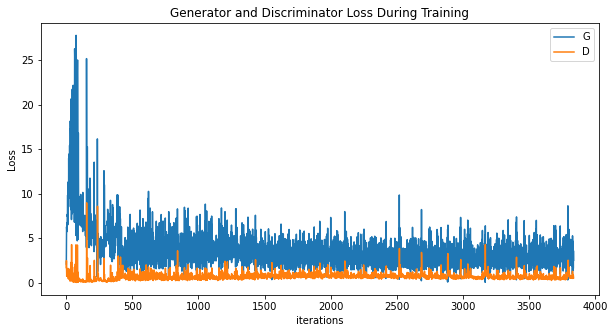

In [19]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_loss,label="G")
plt.plot(D_loss,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()

plt.savefig("figs/loss.png")

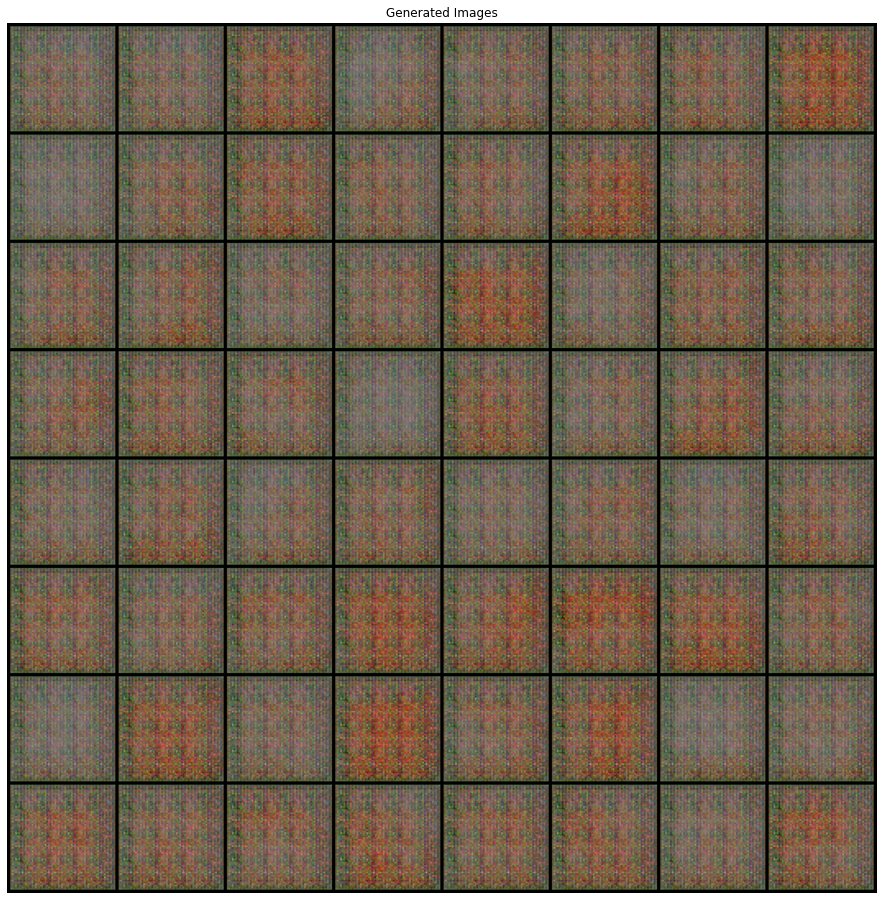

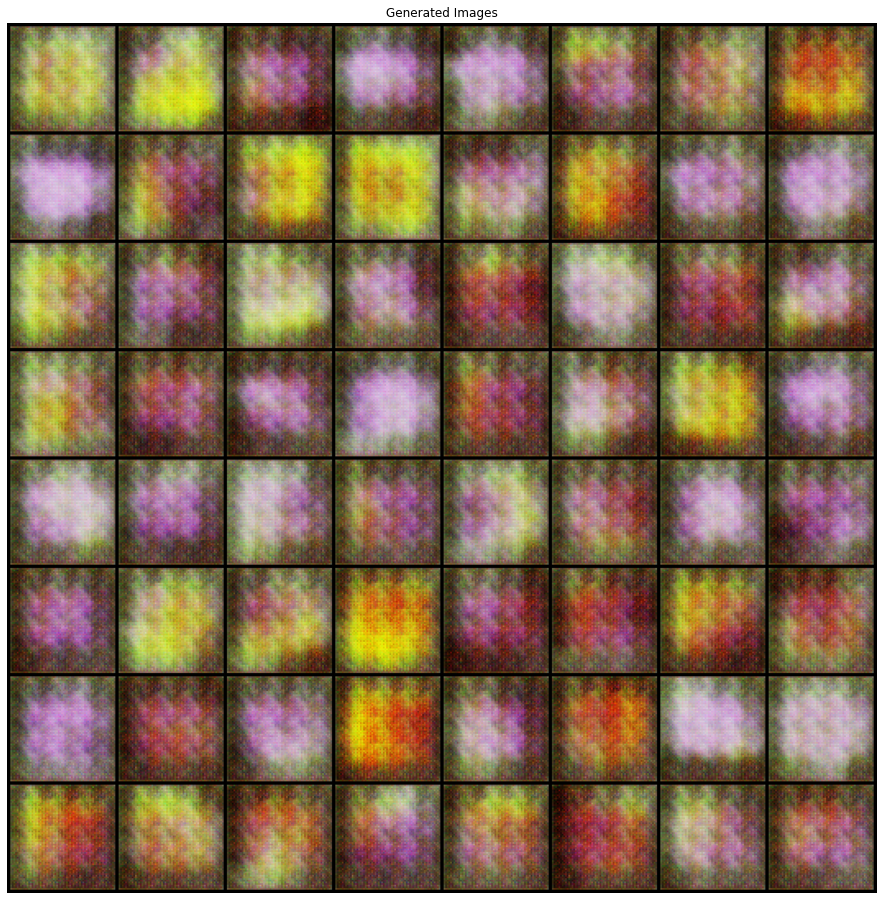

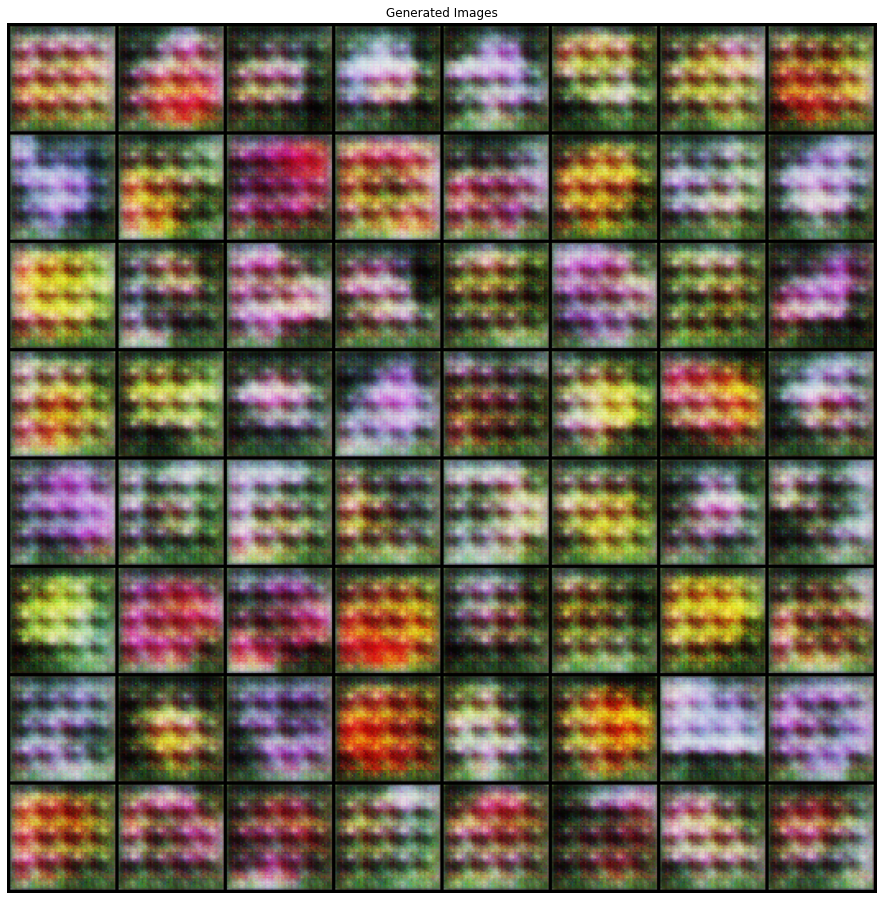

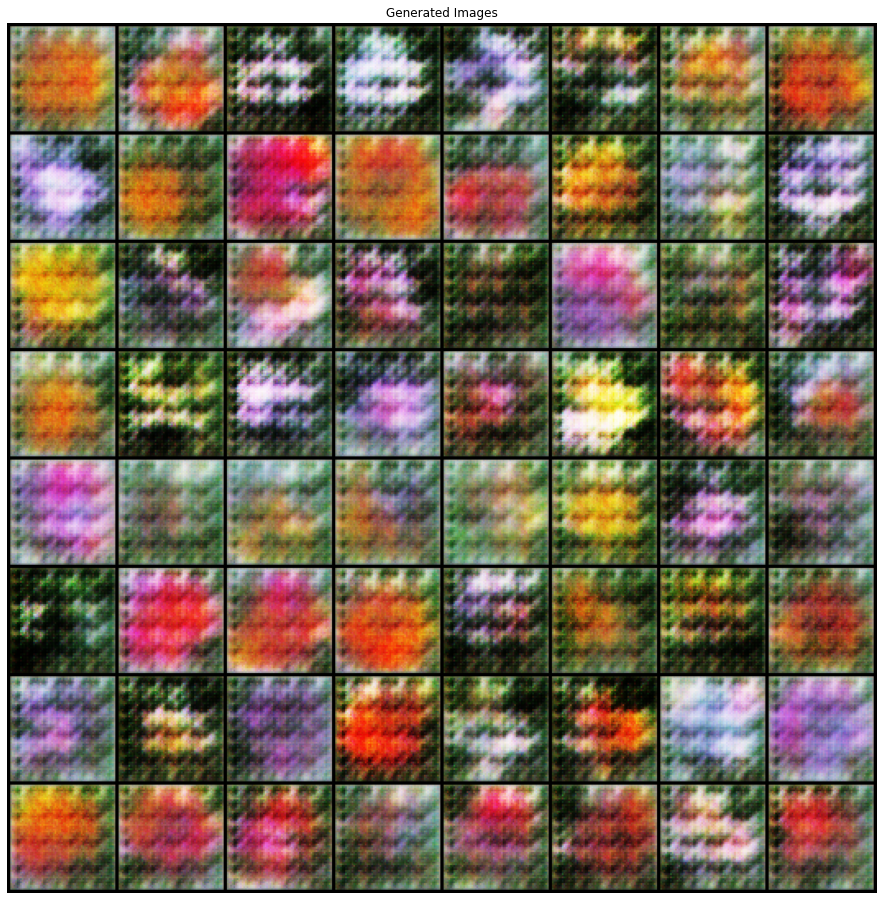

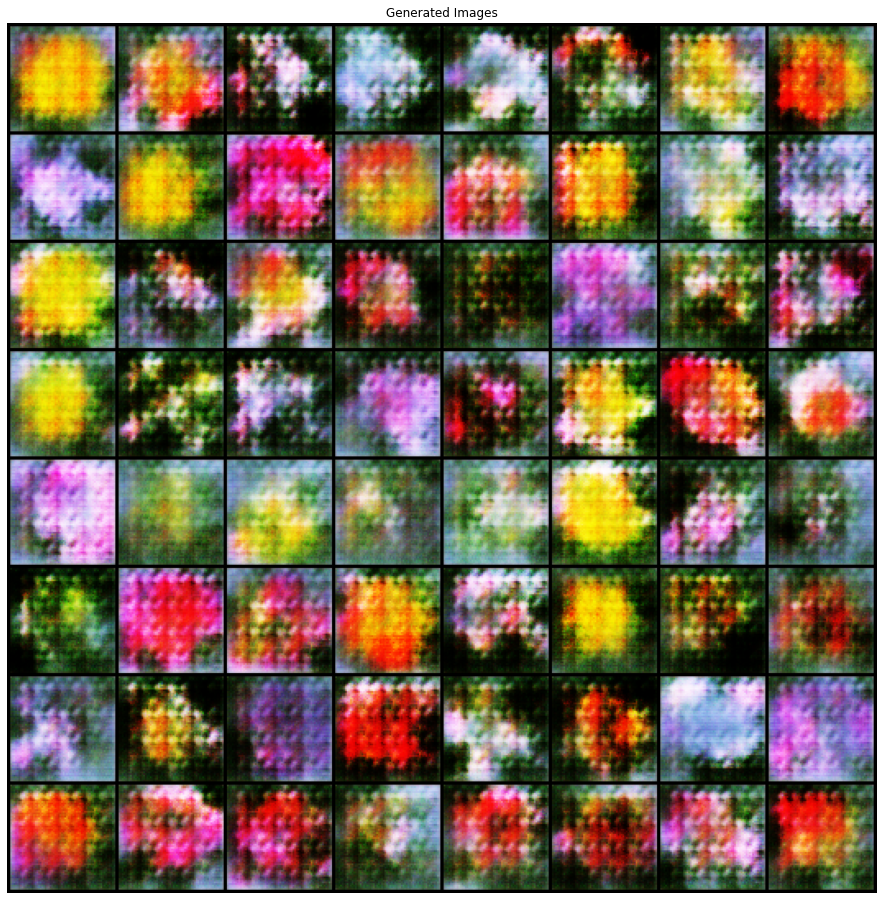

...

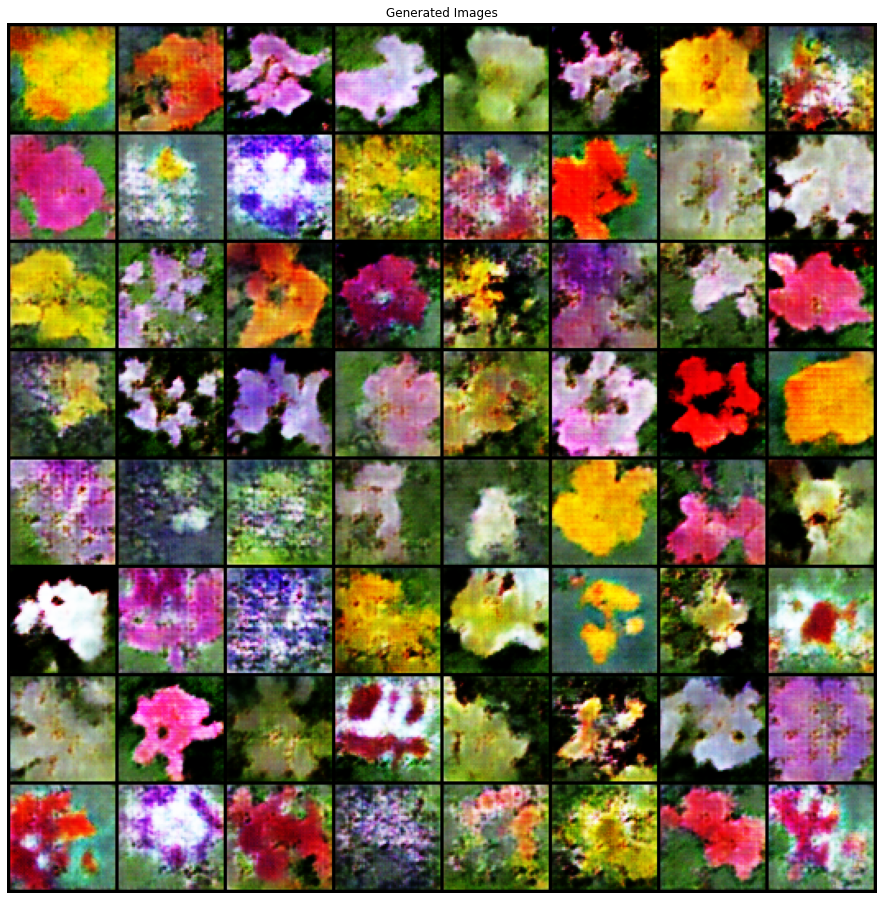

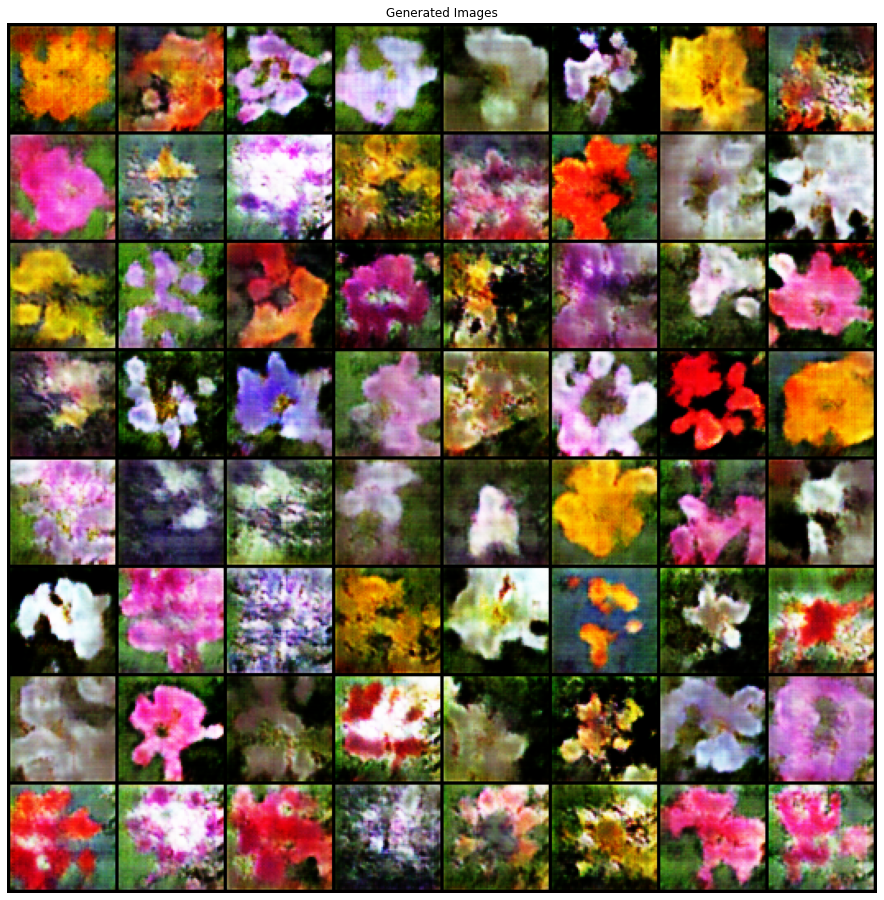

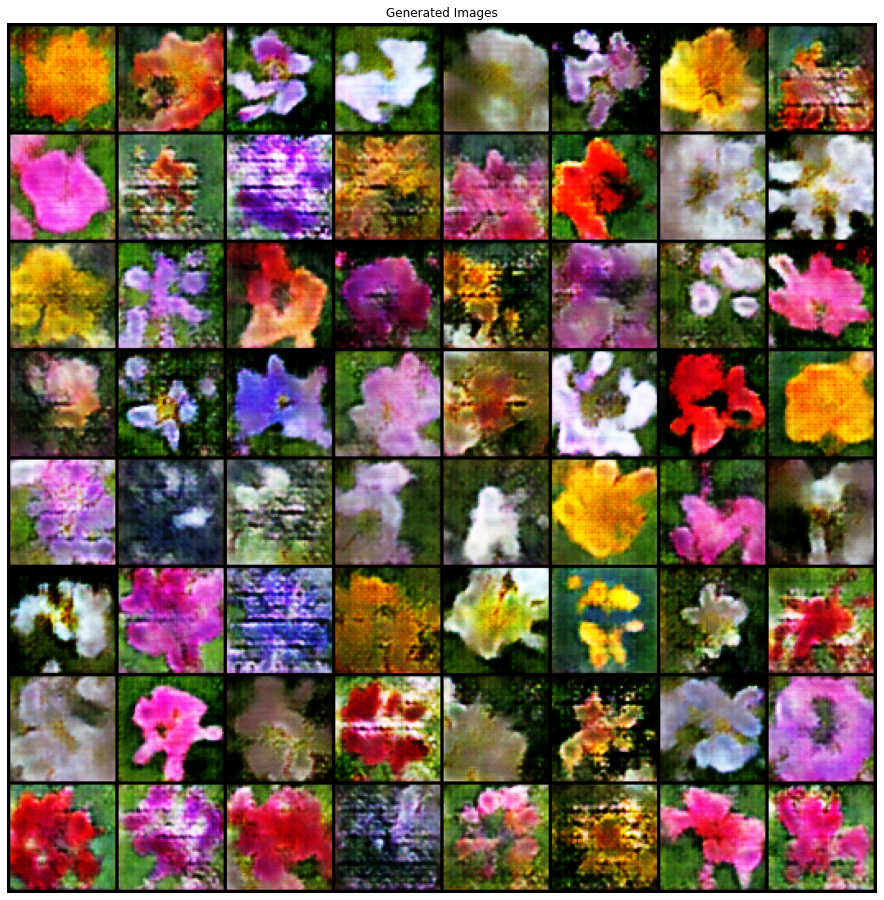

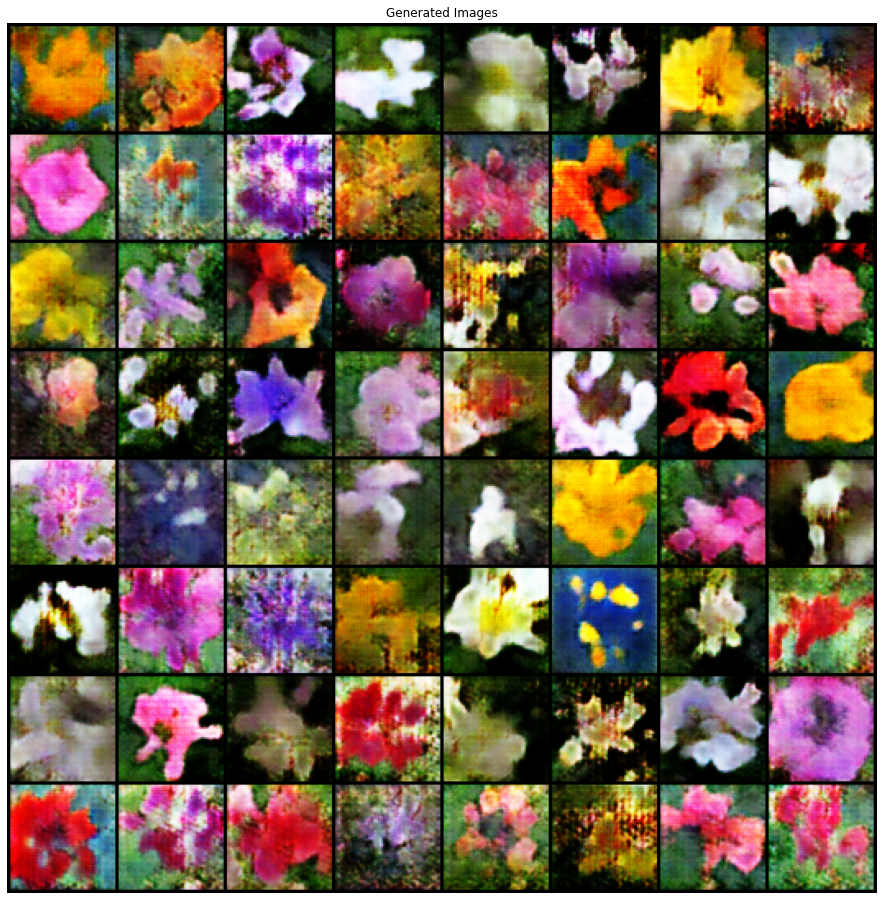

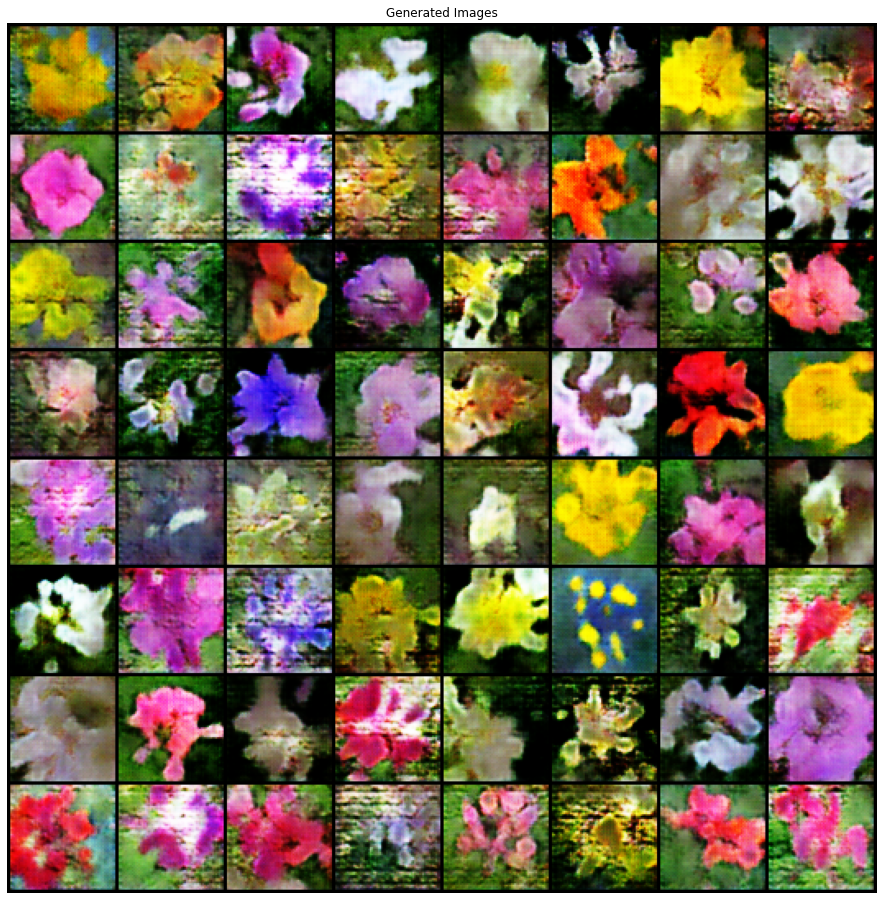

In [25]:
for i, image in enumerate(img_list):
    if (i+1) % 2 == 0: 
        plt.figure(figsize=(16,16))
        plt.axis("off")
        plt.title("Generated Images")
        plt.imshow(np.transpose(vutils.make_grid(img_list[i].to(device)*0.5+0.5, padding=2).cpu(),(1,2,0)))
        plt.savefig("figs/" + str(i+1) + ".png")

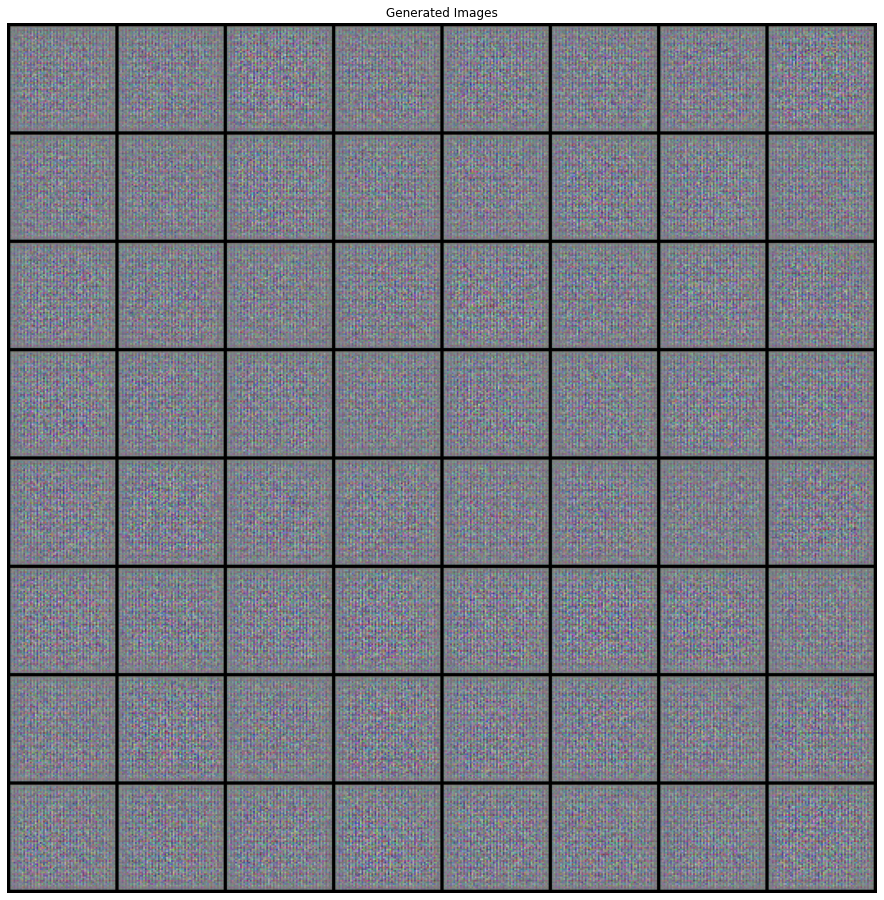

In [26]:
plt.figure(figsize=(16,16))
plt.axis("off")
plt.title("Generated Images")
plt.imshow(np.transpose(vutils.make_grid(img_list[0].to(device)*0.5+0.5, padding=2).cpu(),(1,2,0)))
plt.savefig("figs/1.png")